In [1]:
%load_ext autoreload
%autoreload 2
%env CUDA_VISIBLE_DEVICES=4
import os
import sys
print(sys.executable)
sys.path.append('..')

from torch.utils.tensorboard import SummaryWriter

import torch
import torch.nn as nn
import numpy as np

from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib.backends.backend_pdf import PdfPages
plt.style.use('seaborn-whitegrid')
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

# Utils
from utils.util import num_params, imread, imwrite, impad, rgb, t
from utils.eval_utils import compute_metrics, get_inference_time, eval_diversity

def imshow(array):
    display(Image.fromarray(array))

env: CUDA_VISIBLE_DEVICES=4
/home/dbaranchuk/distill-srflow-env/bin/python3.6


## Setting

In [2]:
scale = 8
dtype = torch.float16
device = 'cuda'

conf_path = f'../confs/SRFlow_DF2K_{scale}X.yml'
data_root = '../data'
model_root = '../pretrained_models'

## Datasets

In [19]:
from torchvision import transforms, datasets
from torch.utils.data import DataLoader
from datasets import DF2K
    
test_dataset = DF2K(data_root, split='test', scale=scale)
assert len(test_dataset) == 100

## Create and load SRFlow Teacher

In [4]:
from utils.util import load_teacher
from utils.eval_utils import get_sr, get_sr_with_epses, get_epses

teacher_model, opt = load_teacher(conf_path, dtype=dtype, device=device)
print(f'Teacher number of parameters {num_params(teacher_model)}')

opt['GT_size'] = 128
opt['device'] = device
opt['eval_dtype'] = dtype

Teacher number of parameters 50821891


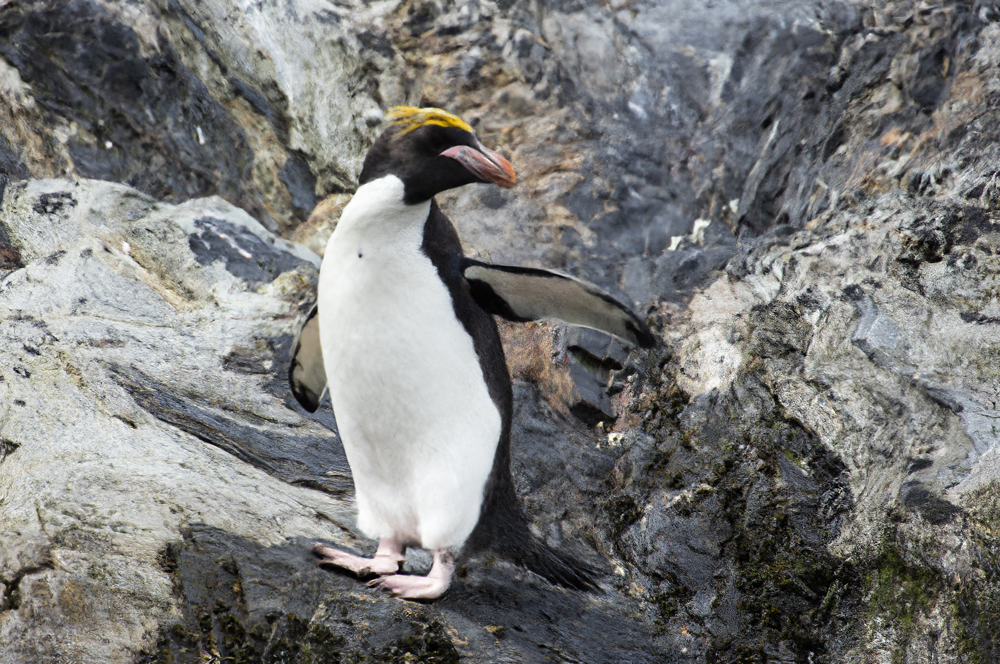

In [20]:
demo_sample = transforms.ToTensor()(test_dataset[0][0])[None]
sr = get_sr(teacher_model, opt, lq=demo_sample)
imshow(rgb(sr))

## Create and load SRFlow Student

In [6]:
from models.modules.Student_arch import StudentX8
from models.modules.RRDBNet_arch import ResidualDenseBlock_3C, RRDB

student_model = StudentX8(rrdb_block=ResidualDenseBlock_3C, flow_block=RRDB, 
                          K=1, opt=opt).to(device, dtype).eval()
student_model.load_state_dict(torch.load(
    os.path.join(model_root, f'SRFlow_Student_DF2K_{scale}X.pth')
))
print(f'Student number of parameters {num_params(student_model)}')

Student number of parameters 16157116


## Create and load RRDB model

In [8]:
from models.modules.RRDBNet_arch import ESRGAN_RRDBNet
rrdb_model = ESRGAN_RRDBNet(**opt['network_G']).to(device, dtype).eval()
rrdb_model.load_state_dict(torch.load(
    os.path.join(model_root, f'RRDB_DF2K_{scale}X.pth')
))
print(f'RRDB number of parameters {num_params(rrdb_model)}')

RRDB number of parameters 16734915


## Measure runtimes

In [9]:
mean, std = get_inference_time(teacher_model, opt, demo_sample)
print(f'Teacher inference time: {mean} +- {std}')

100%|██████████| 100/100 [01:09<00:00,  1.43it/s]

Teacher inference time: 692.0560821533203 +- 14.796500325407404


In [10]:
mean, std = get_inference_time(student_model, opt, demo_sample)
print(f'Student inference time: {mean} +- {std}')

100%|██████████| 100/100 [00:14<00:00,  6.89it/s]

Student inference time: 140.99082244873046 +- 5.218607703583923


In [11]:
mean, std = get_inference_time(rrdb_model, opt, demo_sample, is_rrdb=True)
print(f'RRDB inference time: {mean} +- {std}')

100%|██████████| 100/100 [00:11<00:00,  8.62it/s]

ESRGAN/RRDB inference time: 113.02634544372559 +- 13.170814823630321


## Evaluate

In [12]:
test_dir = f'../results/div2k_teacher_x{scale}/'
compute_metrics(teacher_model, opt, opt['dataroot_LR'], opt['dataroot_GT'], test_dir=test_dir)

Out dir: ../results/div2k_teacher_x8/
conf: tmp, heat: 0.900, name: 0, PSNR: 21.165, SSIM: 0.465, LPIPS: 0.439, LRC PSNR: 51.152
conf: tmp, heat: 0.900, name: 1, PSNR: 29.110, SSIM: 0.707, LPIPS: 0.155, LRC PSNR: 51.251
conf: tmp, heat: 0.900, name: 2, PSNR: 32.040, SSIM: 0.823, LPIPS: 0.137, LRC PSNR: 51.259
conf: tmp, heat: 0.900, name: 3, PSNR: 21.631, SSIM: 0.504, LPIPS: 0.297, LRC PSNR: 51.056
conf: tmp, heat: 0.900, name: 4, PSNR: 22.196, SSIM: 0.446, LPIPS: 0.303, LRC PSNR: 51.243
conf: tmp, heat: 0.900, name: 5, PSNR: 22.771, SSIM: 0.651, LPIPS: 0.223, LRC PSNR: 39.069
conf: tmp, heat: 0.900, name: 6, PSNR: 16.134, SSIM: 0.236, LPIPS: 0.347, LRC PSNR: 43.696
conf: tmp, heat: 0.900, name: 7, PSNR: 21.720, SSIM: 0.608, LPIPS: 0.217, LRC PSNR: 50.864
conf: tmp, heat: 0.900, name: 8, PSNR: 23.730, SSIM: 0.490, LPIPS: 0.363, LRC PSNR: 51.309
conf: tmp, heat: 0.900, name: 9, PSNR: 21.936, SSIM: 0.513, LPIPS: 0.289, LRC PSNR: 51.764
conf: tmp, heat: 0.900, name: 10, PSNR: 21.436, SSIM

conf: tmp, heat: 0.900, name: 89, PSNR: 21.380, SSIM: 0.555, LPIPS: 0.279, LRC PSNR: 51.239
conf: tmp, heat: 0.900, name: 90, PSNR: 21.369, SSIM: 0.574, LPIPS: 0.223, LRC PSNR: 35.043
conf: tmp, heat: 0.900, name: 91, PSNR: 23.206, SSIM: 0.683, LPIPS: 0.214, LRC PSNR: 51.399
conf: tmp, heat: 0.900, name: 92, PSNR: 28.928, SSIM: 0.693, LPIPS: 0.224, LRC PSNR: 51.275
conf: tmp, heat: 0.900, name: 93, PSNR: 24.513, SSIM: 0.639, LPIPS: 0.268, LRC PSNR: 51.554
conf: tmp, heat: 0.900, name: 94, PSNR: 15.619, SSIM: 0.231, LPIPS: 0.384, LRC PSNR: 41.967
conf: tmp, heat: 0.900, name: 95, PSNR: 31.442, SSIM: 0.823, LPIPS: 0.076, LRC PSNR: 52.327
conf: tmp, heat: 0.900, name: 96, PSNR: 11.751, SSIM: 0.231, LPIPS: 0.532, LRC PSNR: 16.533
conf: tmp, heat: 0.900, name: 97, PSNR: 27.588, SSIM: 0.724, LPIPS: 0.116, LRC PSNR: 52.151
conf: tmp, heat: 0.900, name: 98, PSNR: 25.161, SSIM: 0.703, LPIPS: 0.230, LRC PSNR: 50.640
conf: tmp, heat: 0.900, name: 99, PSNR: 21.154, SSIM: 0.583, LPIPS: 0.291, LRC P

In [13]:
test_dir = f'../results/div2k_student_x{scale}/'
compute_metrics(student_model, opt, opt['dataroot_LR'], opt['dataroot_GT'], test_dir=test_dir)

Out dir: ../results/div2k_student_x8/
conf: tmp, heat: 0.900, name: 0, PSNR: 21.906, SSIM: 0.486, LPIPS: 0.432, LRC PSNR: 49.133
conf: tmp, heat: 0.900, name: 1, PSNR: 29.851, SSIM: 0.723, LPIPS: 0.153, LRC PSNR: 48.441
conf: tmp, heat: 0.900, name: 2, PSNR: 31.997, SSIM: 0.826, LPIPS: 0.142, LRC PSNR: 49.321
conf: tmp, heat: 0.900, name: 3, PSNR: 22.062, SSIM: 0.516, LPIPS: 0.291, LRC PSNR: 47.982
conf: tmp, heat: 0.900, name: 4, PSNR: 23.504, SSIM: 0.501, LPIPS: 0.297, LRC PSNR: 49.044
conf: tmp, heat: 0.900, name: 5, PSNR: 22.780, SSIM: 0.651, LPIPS: 0.232, LRC PSNR: 49.423
conf: tmp, heat: 0.900, name: 6, PSNR: 16.490, SSIM: 0.244, LPIPS: 0.350, LRC PSNR: 44.567
conf: tmp, heat: 0.900, name: 7, PSNR: 21.856, SSIM: 0.615, LPIPS: 0.227, LRC PSNR: 47.703
conf: tmp, heat: 0.900, name: 8, PSNR: 24.196, SSIM: 0.511, LPIPS: 0.337, LRC PSNR: 49.392
conf: tmp, heat: 0.900, name: 9, PSNR: 22.580, SSIM: 0.548, LPIPS: 0.280, LRC PSNR: 49.660
conf: tmp, heat: 0.900, name: 10, PSNR: 21.953, SSIM

conf: tmp, heat: 0.900, name: 89, PSNR: 21.470, SSIM: 0.560, LPIPS: 0.284, LRC PSNR: 50.344
conf: tmp, heat: 0.900, name: 90, PSNR: 21.678, SSIM: 0.572, LPIPS: 0.230, LRC PSNR: 47.048
conf: tmp, heat: 0.900, name: 91, PSNR: 23.081, SSIM: 0.676, LPIPS: 0.215, LRC PSNR: 46.498
conf: tmp, heat: 0.900, name: 92, PSNR: 28.950, SSIM: 0.700, LPIPS: 0.233, LRC PSNR: 49.924
conf: tmp, heat: 0.900, name: 93, PSNR: 24.561, SSIM: 0.645, LPIPS: 0.259, LRC PSNR: 49.696
conf: tmp, heat: 0.900, name: 94, PSNR: 15.766, SSIM: 0.237, LPIPS: 0.385, LRC PSNR: 46.548
conf: tmp, heat: 0.900, name: 95, PSNR: 31.367, SSIM: 0.827, LPIPS: 0.077, LRC PSNR: 52.120
conf: tmp, heat: 0.900, name: 96, PSNR: 16.334, SSIM: 0.356, LPIPS: 0.276, LRC PSNR: 42.586
conf: tmp, heat: 0.900, name: 97, PSNR: 27.489, SSIM: 0.747, LPIPS: 0.108, LRC PSNR: 49.466
conf: tmp, heat: 0.900, name: 98, PSNR: 25.487, SSIM: 0.712, LPIPS: 0.237, LRC PSNR: 47.859
conf: tmp, heat: 0.900, name: 99, PSNR: 21.425, SSIM: 0.583, LPIPS: 0.278, LRC P

In [14]:
test_dir = f'../results/div2k_rrdb_x{scale}/'
compute_metrics(rrdb_model, opt, opt['dataroot_LR'], opt['dataroot_GT'], test_dir=test_dir, is_rrdb=True)

Out dir: ../results/div2k_rrdb_x8/
conf: tmp, heat: 0.900, name: 0, PSNR: 25.060, SSIM: 0.656, LPIPS: 0.503, LRC PSNR: 44.225
conf: tmp, heat: 0.900, name: 1, PSNR: 31.835, SSIM: 0.826, LPIPS: 0.246, LRC PSNR: 48.650
conf: tmp, heat: 0.900, name: 2, PSNR: 34.601, SSIM: 0.931, LPIPS: 0.132, LRC PSNR: 48.471
conf: tmp, heat: 0.900, name: 3, PSNR: 23.891, SSIM: 0.630, LPIPS: 0.450, LRC PSNR: 46.046
conf: tmp, heat: 0.900, name: 4, PSNR: 25.258, SSIM: 0.613, LPIPS: 0.656, LRC PSNR: 47.985
conf: tmp, heat: 0.900, name: 5, PSNR: 25.166, SSIM: 0.767, LPIPS: 0.355, LRC PSNR: 44.651
conf: tmp, heat: 0.900, name: 6, PSNR: 18.406, SSIM: 0.346, LPIPS: 0.734, LRC PSNR: 37.001
conf: tmp, heat: 0.900, name: 7, PSNR: 24.515, SSIM: 0.719, LPIPS: 0.398, LRC PSNR: 44.517
conf: tmp, heat: 0.900, name: 8, PSNR: 27.453, SSIM: 0.678, LPIPS: 0.476, LRC PSNR: 45.565
conf: tmp, heat: 0.900, name: 9, PSNR: 24.243, SSIM: 0.643, LPIPS: 0.585, LRC PSNR: 45.796
conf: tmp, heat: 0.900, name: 10, PSNR: 25.698, SSIM: 0

conf: tmp, heat: 0.900, name: 89, PSNR: 23.605, SSIM: 0.653, LPIPS: 0.464, LRC PSNR: 46.071
conf: tmp, heat: 0.900, name: 90, PSNR: 23.424, SSIM: 0.689, LPIPS: 0.333, LRC PSNR: 46.065
conf: tmp, heat: 0.900, name: 91, PSNR: 24.271, SSIM: 0.755, LPIPS: 0.239, LRC PSNR: 46.200
conf: tmp, heat: 0.900, name: 92, PSNR: 30.425, SSIM: 0.772, LPIPS: 0.496, LRC PSNR: 48.563
conf: tmp, heat: 0.900, name: 93, PSNR: 27.575, SSIM: 0.776, LPIPS: 0.327, LRC PSNR: 44.418
conf: tmp, heat: 0.900, name: 94, PSNR: 18.371, SSIM: 0.359, LPIPS: 0.721, LRC PSNR: 40.378
conf: tmp, heat: 0.900, name: 95, PSNR: 34.329, SSIM: 0.911, LPIPS: 0.202, LRC PSNR: 47.570
conf: tmp, heat: 0.900, name: 96, PSNR: 19.308, SSIM: 0.520, LPIPS: 0.555, LRC PSNR: 39.182
conf: tmp, heat: 0.900, name: 97, PSNR: 29.557, SSIM: 0.853, LPIPS: 0.323, LRC PSNR: 48.942
conf: tmp, heat: 0.900, name: 98, PSNR: 27.068, SSIM: 0.814, LPIPS: 0.248, LRC PSNR: 47.420
conf: tmp, heat: 0.900, name: 99, PSNR: 22.764, SSIM: 0.704, LPIPS: 0.368, LRC P

# Qualitative results

In [40]:
from PIL import ImageDraw

@torch.no_grad()
def get_samples(opt, sample_id, bbox):
    lr, hr = test_dataset[sample_id]
    lq = transforms.ToTensor()(lr)[None].to(opt['device'], opt['eval_dtype'])
    epses = get_epses(opt, 1, lq.shape,  opt['heat'])
    epses = [eps.to(opt['device'], opt['eval_dtype']) for eps in epses]
    
    y1,y2,x1,x2 = bbox
    print('SRFlow Teacher')
    sr_t = get_sr(teacher_model, opt, lq=lq, epses=epses)
    sr_t = rgb(sr_t)[y1:y2, x1:x2, :]
    imshow(sr_t)
    
    print('SRFlow Student')
    sr_s = get_sr(student_model, opt, lq=lq, epses=epses)
    sr_s = rgb(sr_s)[y1:y2, x1:x2, :]
    imshow(sr_s)
    
    print('RRDB')
    sr_e = get_sr(rrdb_model, opt, lq, is_rrdb=True)
    sr_e = rgb(sr_e)[y1:y2, x1:x2, :]
    imshow(sr_e)
    
    bicubic_sr = np.asarray(lr.resize(hr.size, Image.BICUBIC))[y1:y2, x1:x2, :]
    nearest_lr = np.asarray(lr.resize(hr.size, Image.NEAREST))[y1:y2, x1:x2, :]
    hr = np.asarray(hr)[y1:y2, x1:x2, :]
    return nearest_lr, bicubic_sr, sr_s, sr_t, sr_e, hr


def visualize(bboxes=[(112,256,256,400), (384,528,568,712)], 
              title="IMG807", filename='lake_x8.pdf'):
    fig, f_axs = plt.subplots(ncols=8, nrows=2)
    fig.set_size_inches((20, 5))
    gs = f_axs[1, 2].get_gridspec()
    # remove the underlying axes
    for ax in f_axs[:, 0]:
        ax.remove()
    for ax in f_axs[:, 1]:
        ax.remove()

    axbig = fig.add_subplot(gs[:, :1])
    axbig.set_title(title)

    image = Image.fromarray(hr)
    draw = ImageDraw.Draw(image)
    for i, bbox in enumerate(bboxes):
        y1, y2, x1, x2 = bbox
        color = (0, 0, 255) if i == 0 else (255, 0, 0)
        draw.rectangle((x1,y1,x2,y2), width=3, outline=color)
    axbig.imshow(image)
    axbig.set_axis_off()
    axbig.set_position((-0.08, 0.13, 0.60, 0.748))

    srs = {'LR': nearest_lr, 'Bicubic': bicubic_sr, 'RRDB': sr_e,
           'SRFlow Student':sr_s, 'SRFlow Teacher':sr_t, 'HR':hr}

    for i, bbox in enumerate(bboxes):
        y1,y2,x1,x2 = bbox
        for ax, (name, sample) in zip(f_axs[i, 2:].flatten(), srs.items()):
            crop = sample
            ax.set_frame_on(True)
            ax.set_title(name)
            ax.imshow(Image.fromarray(crop[y1:y2,x1:x2]))
            ax.tick_params(
                axis='both', which='both',
                bottom=False, top=False, left=False, right=False,
                labelbottom=False,labelleft=False)

            for spine in ax.spines.values():
                spine.set_edgecolor('blue' if i == 0 else 'red')
                spine.set_linewidth(2)
            ax.grid(False)
    
    if filename:
        pp = PdfPages(filename)
        pp.savefig(fig, bbox_inches='tight')
        pp.close()

SRFlow Teacher


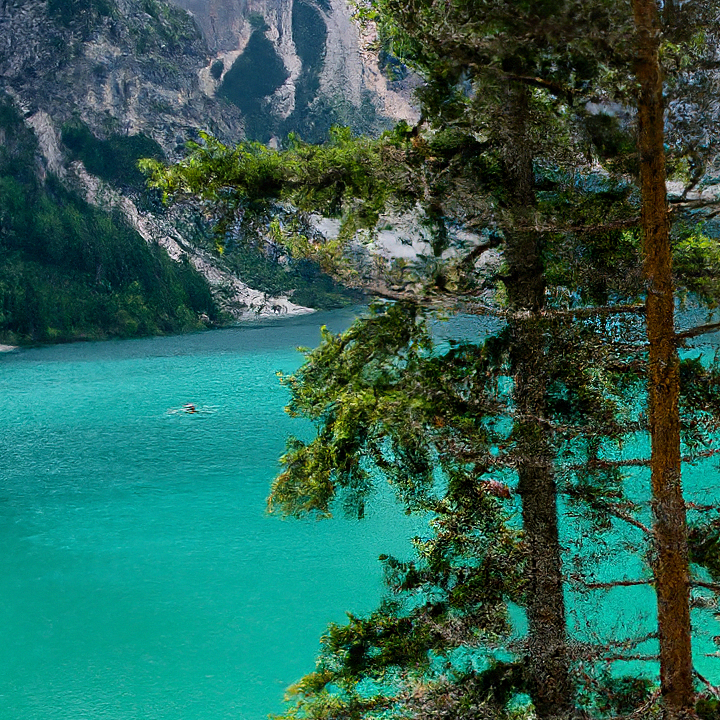

SRFlow Student


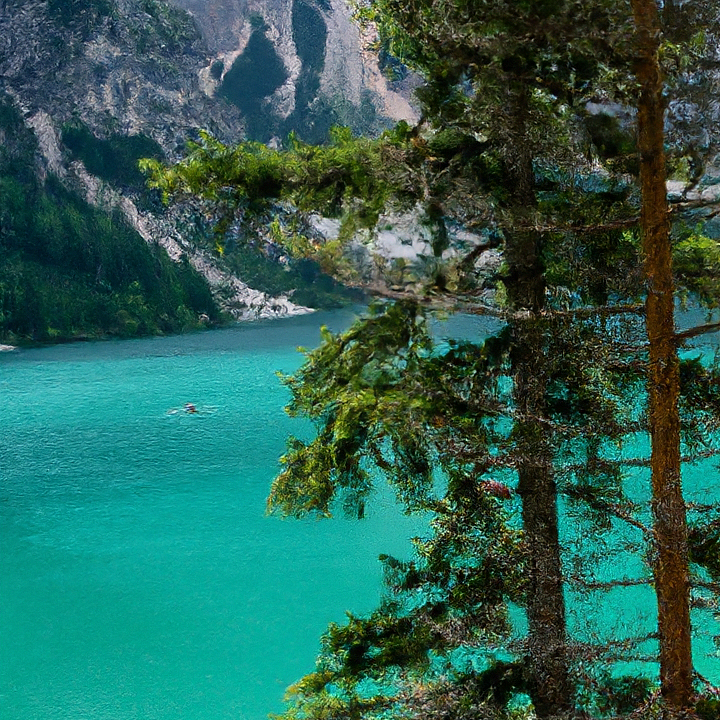

RRDB


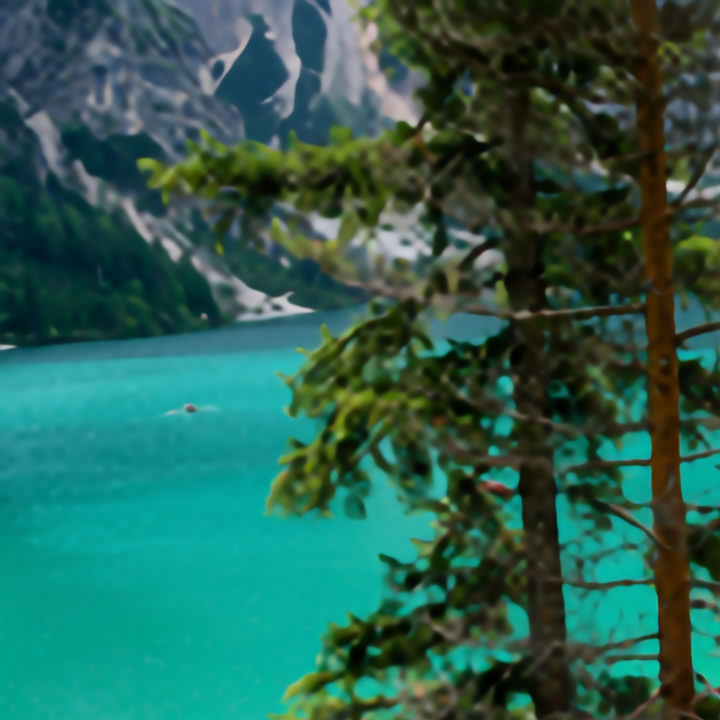

In [41]:
bicubic_sr, nearest_lr, sr_s, sr_t, sr_e, hr = get_samples(opt, 6, (0,720,0,720))

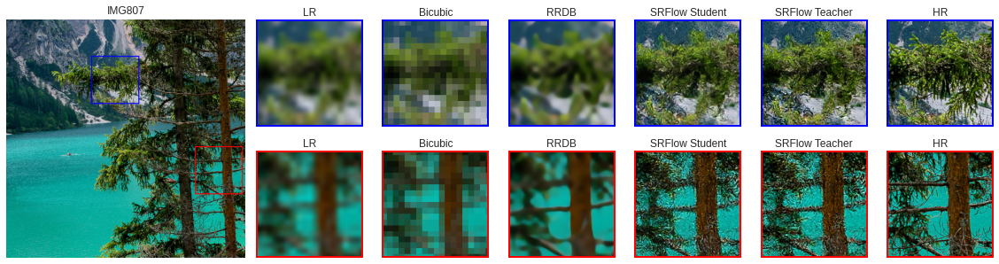

In [42]:
visualize(title='IMG807', filename='lake_x8.pdf')

SRFlow Teacher


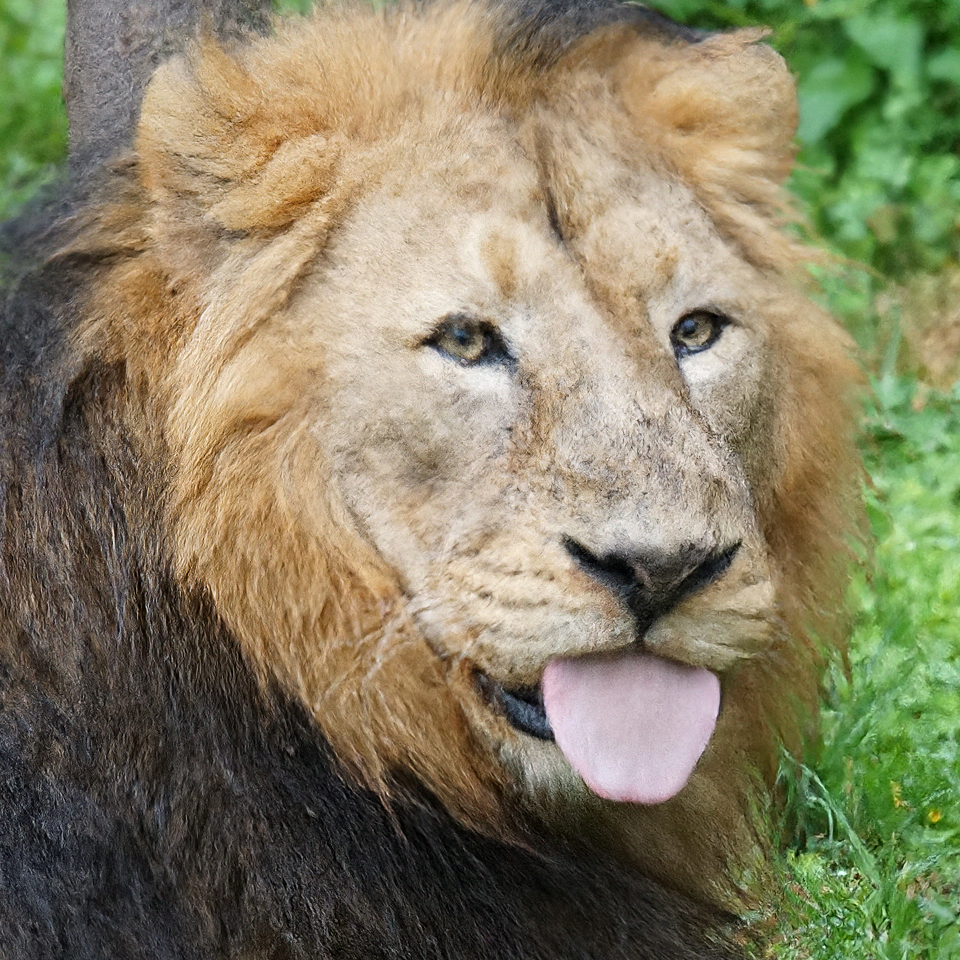

SRFlow Student


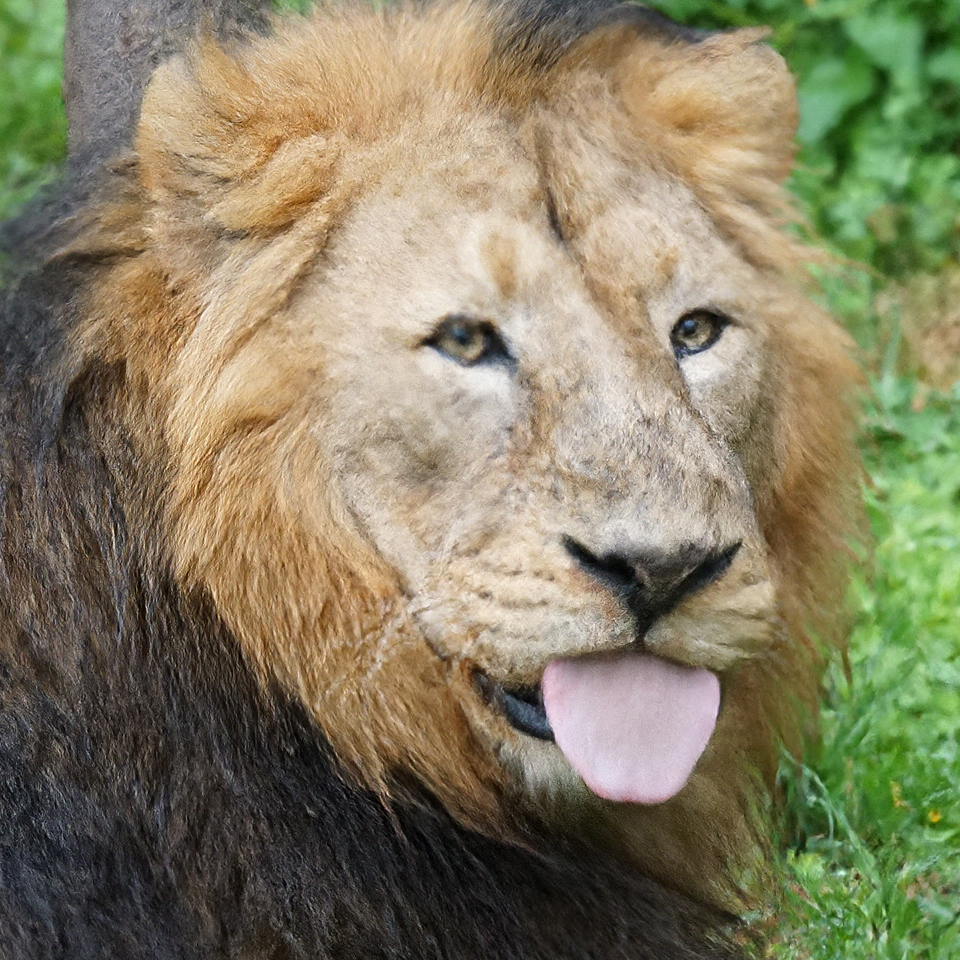

RRDB


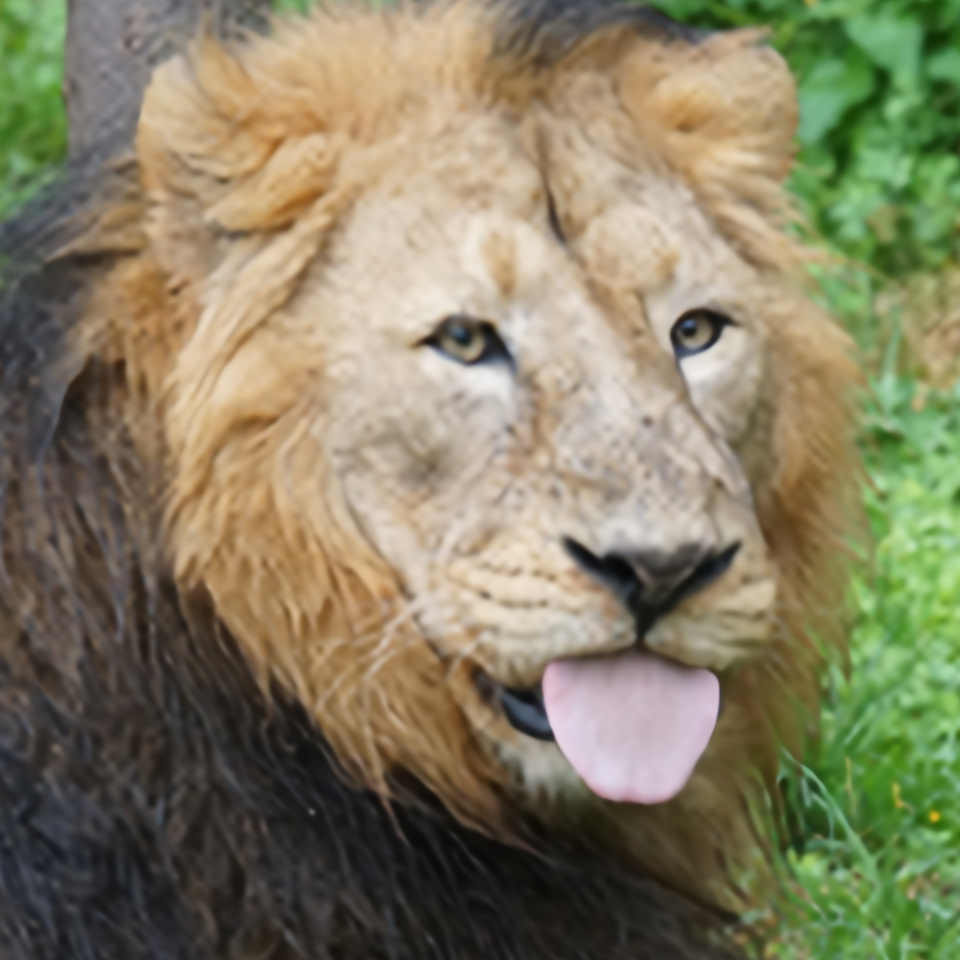

In [46]:
bicubic_sr, nearest_lr, sr_s, sr_t, sr_e, hr = get_samples(opt, 8, (120,1080, 460,1420))

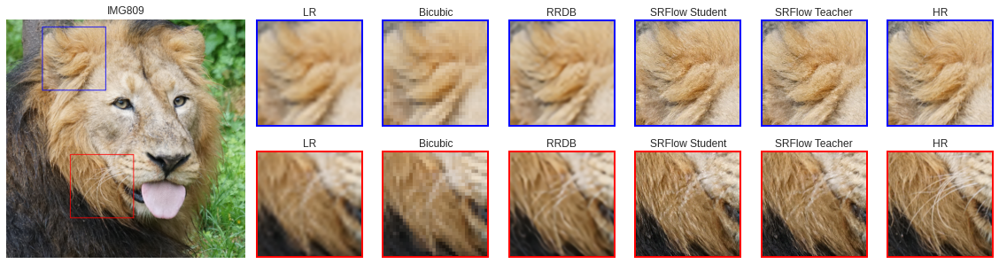

In [47]:
visualize(bboxes=[(32,288,144,400), (544,800,256,512)], title='IMG809', filename='lion_x8.pdf')

SRFlow Teacher


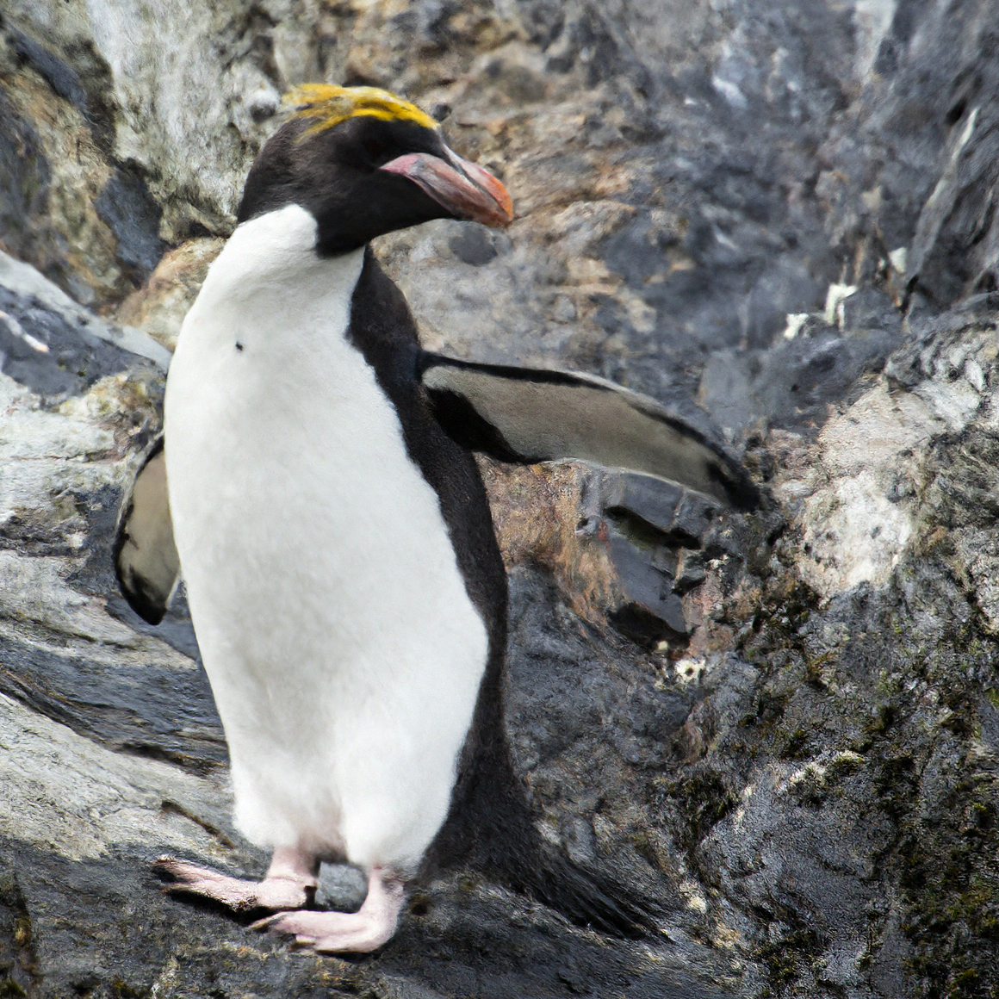

SRFlow Student


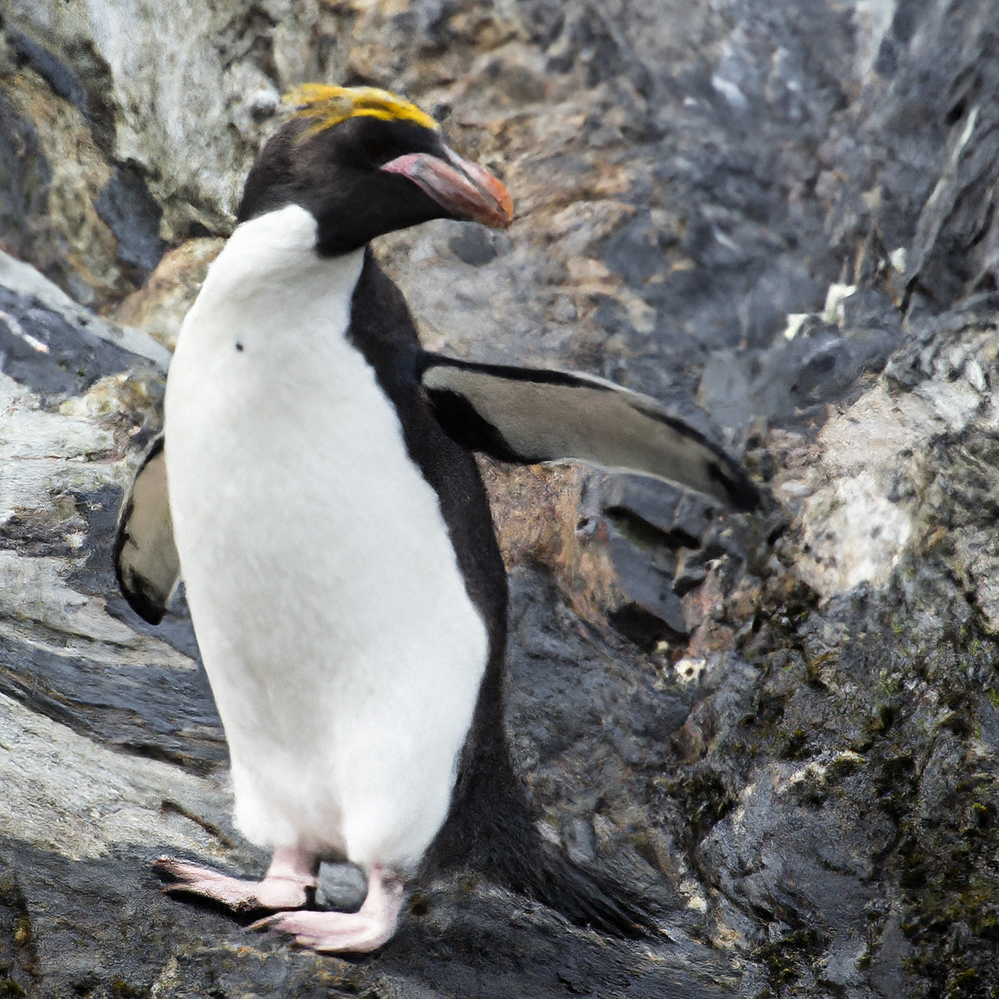

RRDB


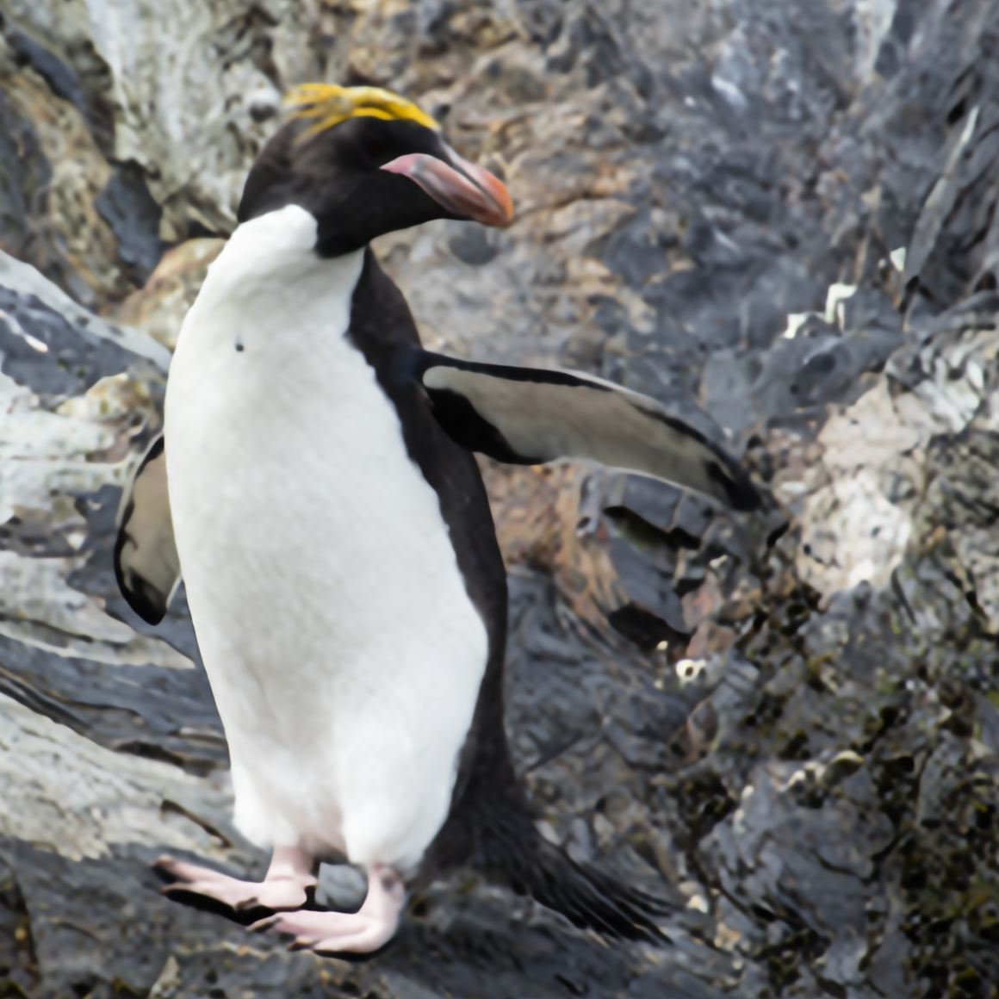

In [48]:
bicubic_sr, nearest_lr, sr_s, sr_t, sr_e, hr = get_samples(opt, 0, (120,1280, 460,1620))

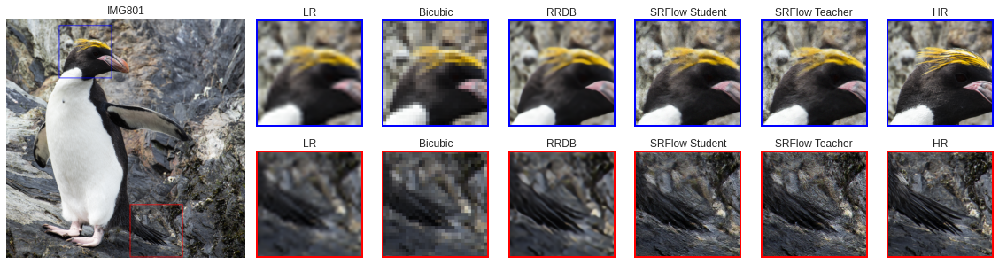

In [49]:
visualize(bboxes=[(32,288,256,512), (900,1156,600,856)], title='IMG801', filename='penguin_x8.pdf')

SRFlow Teacher


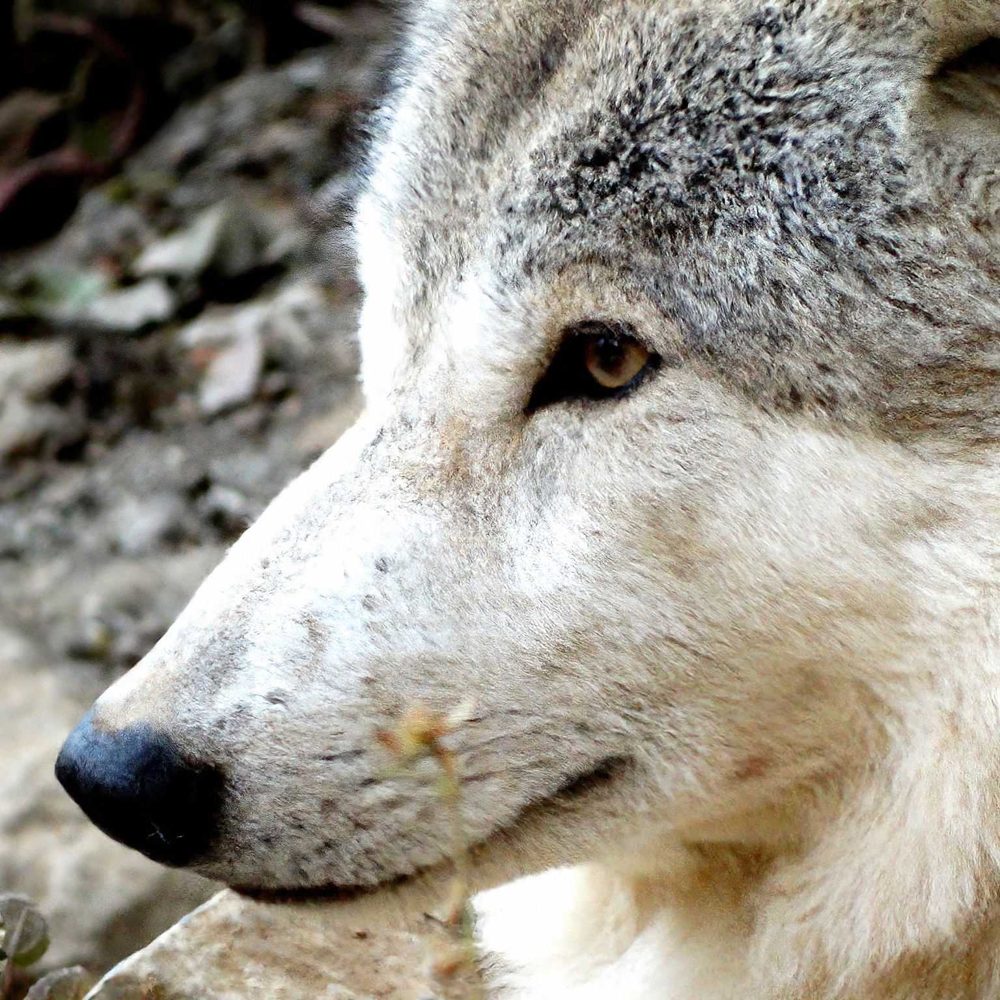

SRFlow Student


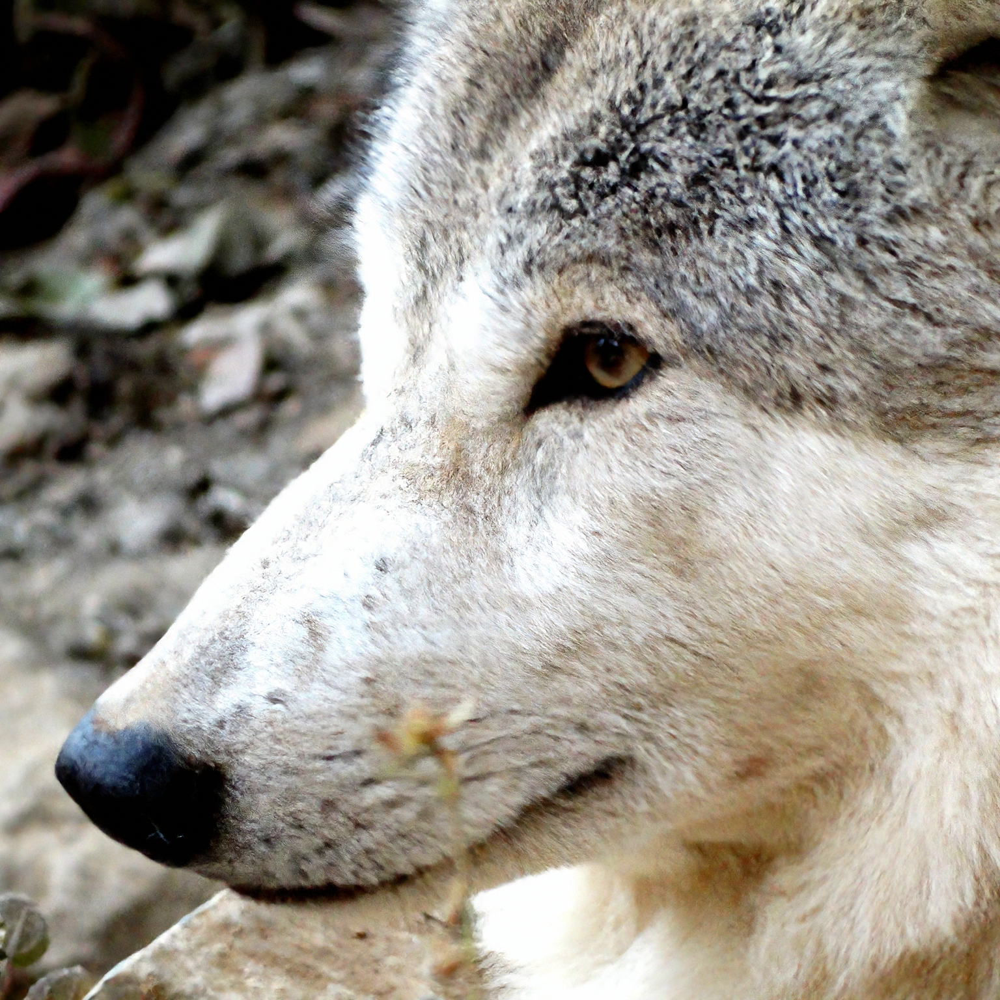

RRDB


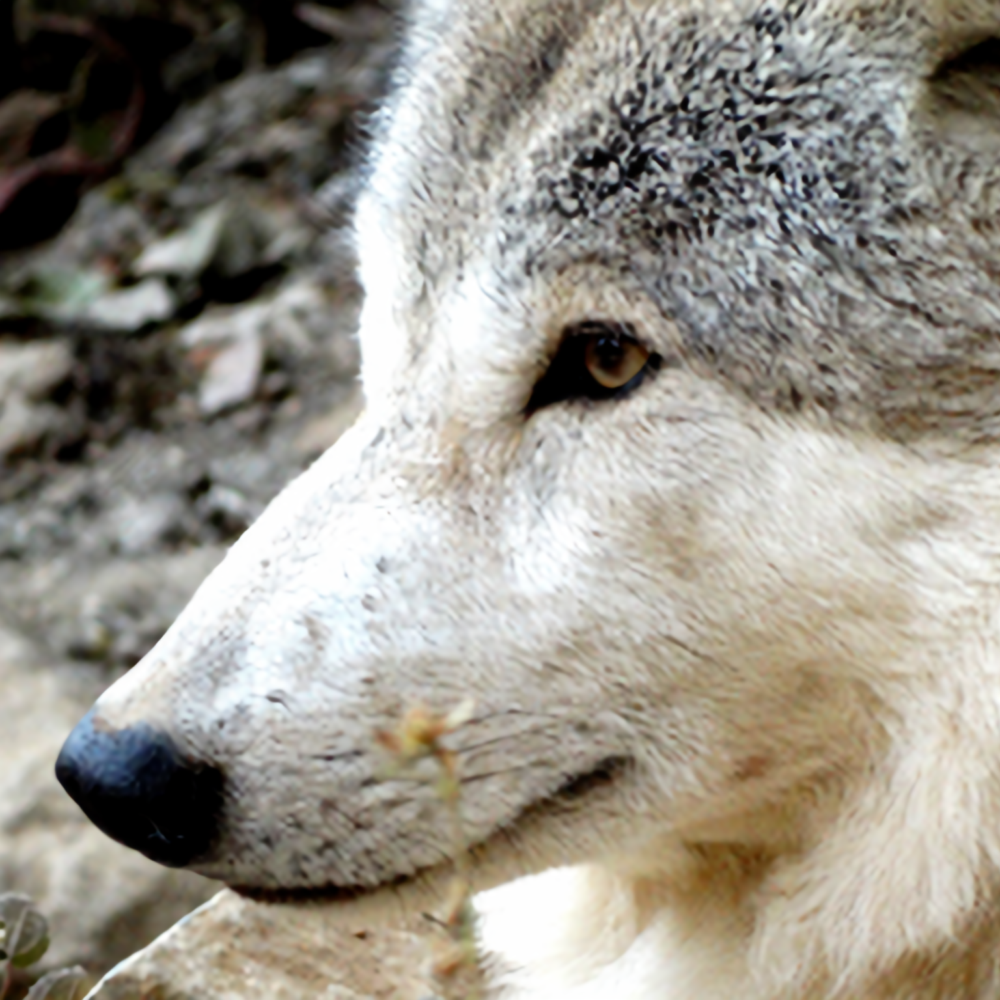

In [50]:
bicubic_sr, nearest_lr, sr_s, sr_t, sr_e, hr = get_samples(opt, 4, (0,1536, 0,1536))

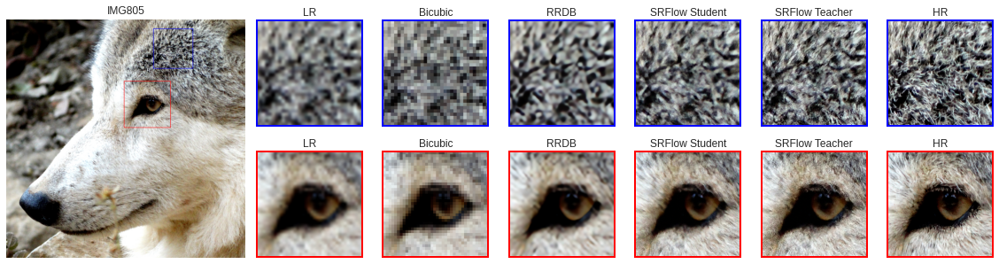

In [51]:
visualize(bboxes=[(64,320,944,1200), (400,700,756,1056)], title='IMG805', filename='wolf_x8.pdf')

# Diversity

In [ ]:
# Note that it takes ~7 hours 
teacher_diversity = eval_diversity(teacher_model, opt, opt['dataroot_LR'])
student_diversity = eval_diversity(student_model, opt, opt['dataroot_LR'])

 21%|██        | 21/100 [43:18<2:45:45, 125.90s/it]

In [ ]:
print(f'SRFlow Teacher diversity: {teacher_diversity}')
print(f'SRFlow Student diversity: {student_diversity}')